<a href="https://colab.research.google.com/github/dgscharan/Computer_vision/blob/main/Invoice_processing_steps.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


Installing Dependancies



In [ ]:
!sudo apt install tesseract-ocr 
!pip install pytesseract
!pip install easyocr

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 14 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 1s (4,991 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl

In [ ]:
import cv2
import numpy as np 
import pytesseract
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt
import PIL
from PIL import ImageDraw


In [ ]:
import easyocr
reader = easyocr.Reader(['en'], gpu = True)

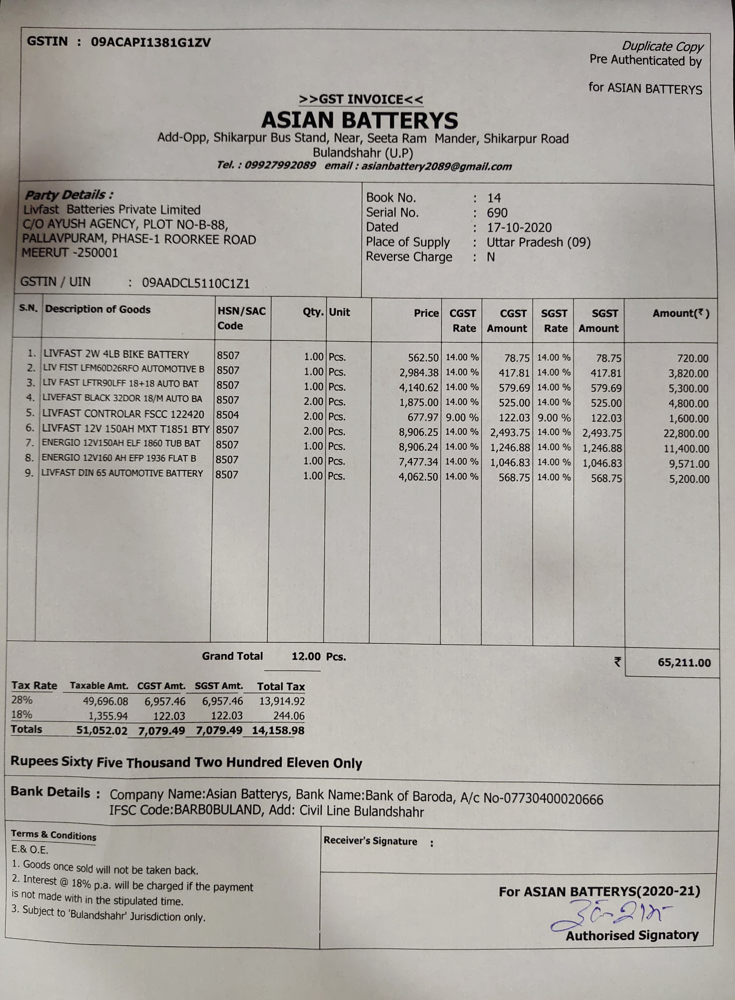

In [ ]:
im = PIL.Image.open('./Sampleinv2.jpg')
im

In [ ]:
bounds = reader.readtext('./Sampleinv2.jpg')
bounds

[([[96, 129], [264, 129], [264, 181], [96, 181]], 'GSTIN', 0.5077255368232727),
 ([[338, 130], [808, 130], [808, 191], [338, 191]],
  '09ACAPI1381G1ZV',
  0.35511842370033264),
 ([[2567.013606076168, 147.08163645700714],
   [2683.7577712633115, 164.3123773883398],
   [2672.986393923832, 218.91836354299286],
   [2556.2422287366885, 201.6876226116602]],
  'Copy',
  0.9053074717521667),
 ([[2357, 150], [2561, 150], [2561, 205], [2357, 205]],
  'Duplicate',
  0.9861509799957275),
 ([[2231, 195], [2672, 195], [2672, 269], [2231, 269]],
  'Pre Authenticated by',
  0.7891562581062317),
 ([[2226, 303], [2675, 303], [2675, 370], [2226, 370]],
  'for ASIAN BATTERYS',
  0.1776137351989746),
 ([[1130, 348], [1613, 348], [1613, 404], [1130, 404]],
  '>>GST INVOICE<<',
  0.34137845039367676),
 ([[988, 410], [1749, 410], [1749, 501], [988, 501]],
  'ASIAN BATTERYS',
  0.6541649103164673),
 ([[589, 482], [2170, 482], [2170, 567], [589, 567]],
  'Add-Opp, Shikarpur Bus Stand, Near, Seeta Ram Mander, Sh

Text Detection

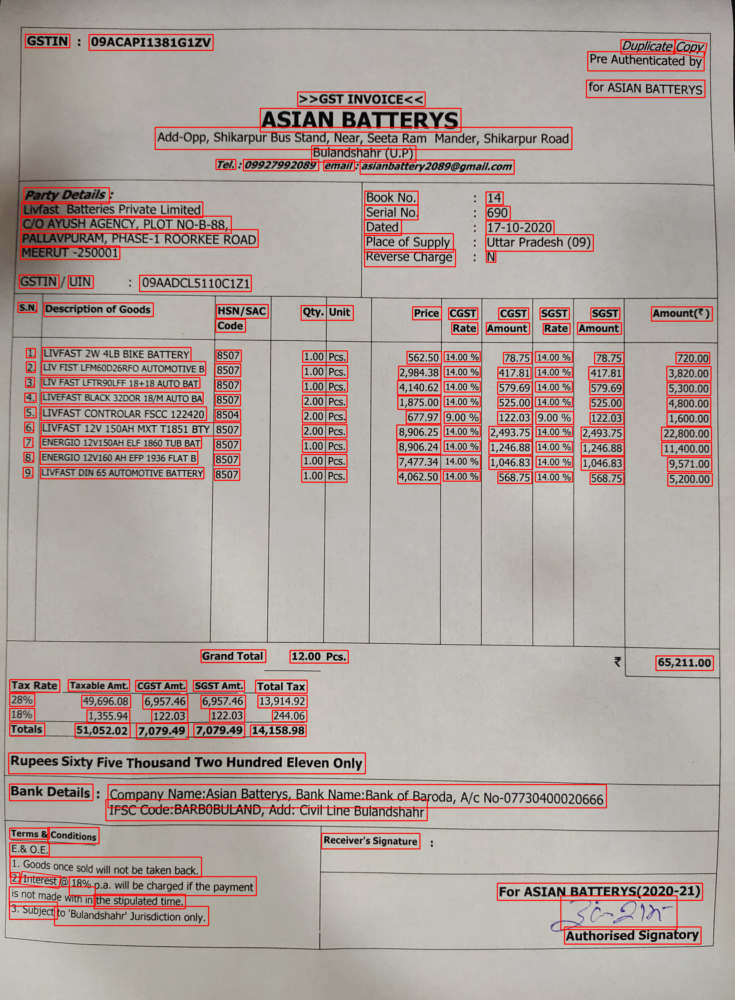

In [ ]:
def draw_boxes(image, bounds, color = "red", width = 4):
    draw  = ImageDraw.Draw(image)
    for bound in bounds:
        p0, p1, p2, p3 = bound[0]
        draw.line([*p0, *p1, *p2, *p3, *p0], fill = color, width = width)
    return image

draw_boxes(im, bounds)

Layout detection

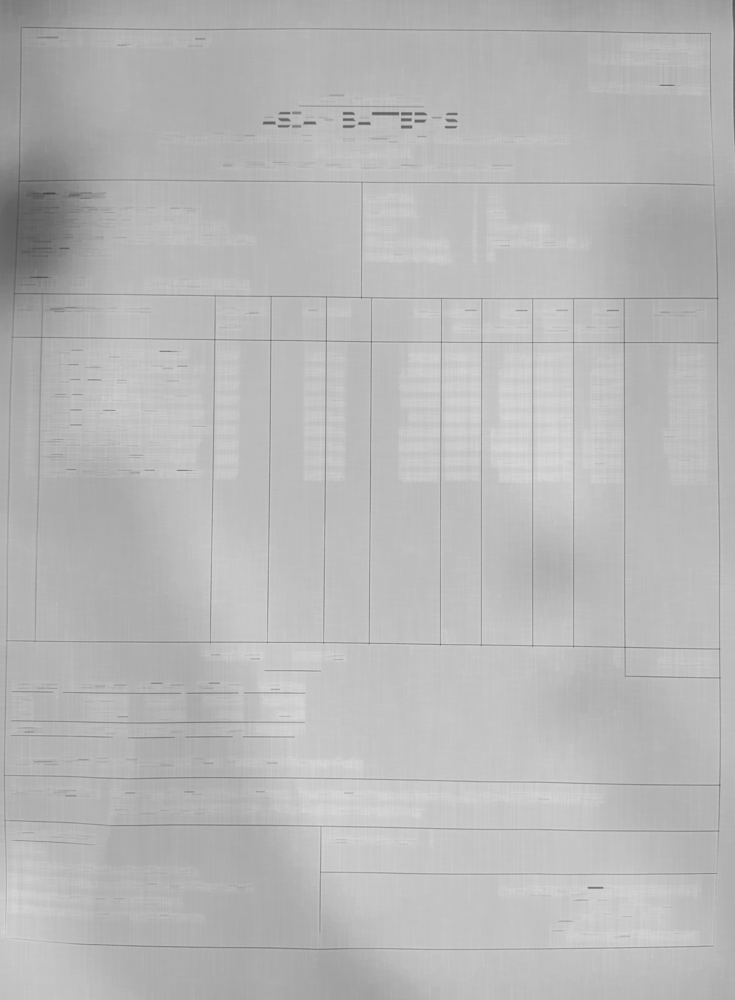

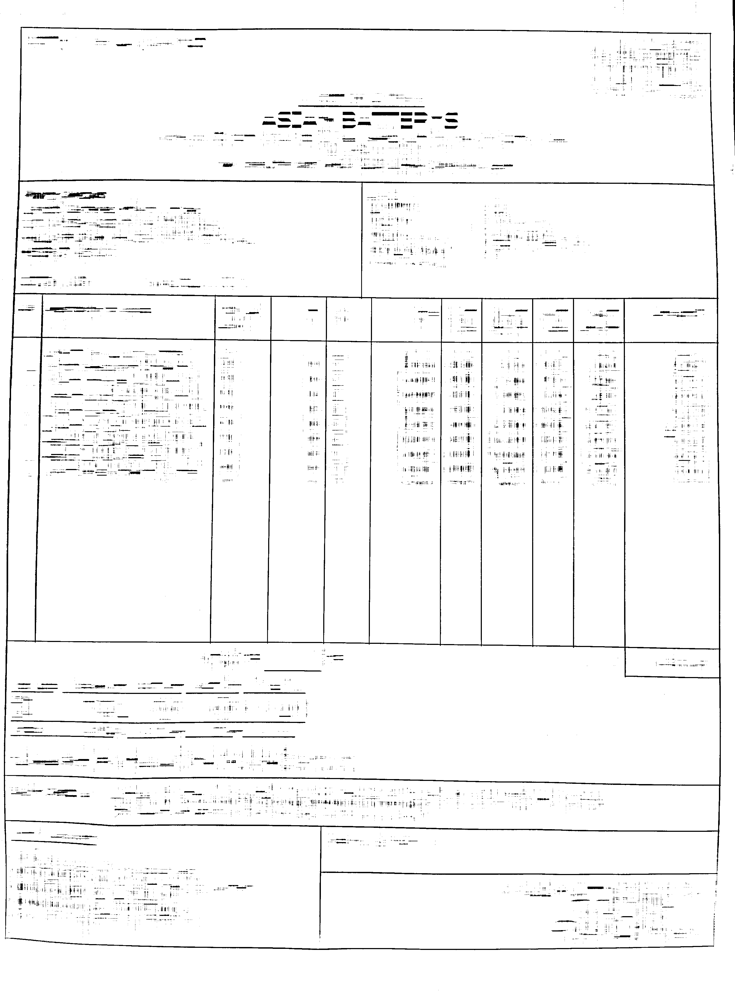

In [ ]:
imgi= cv2.imread('./Sampleinv2.jpg', 0)
img_bin = 255-imgi
kernel_length = np.array(img_bin).shape[1]//80
vertical_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (1, kernel_length))
horizontal_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (kernel_length, 1))
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(1,1))
vert_struct = cv2.erode(img_bin, vertical_kernel, iterations=3)
vert_img = cv2.dilate(vert_struct, vertical_kernel, iterations=3)
horiz_struct = cv2.erode(img_bin, horizontal_kernel, iterations=1)
horiz_img = cv2.dilate(horiz_struct, horizontal_kernel, iterations=1)
alpha = 0.5
beta = 1.0 - alpha
combined_image = cv2.addWeighted(vert_img, alpha, horiz_img, beta, 0.0)
combined_image = cv2.erode(~combined_image, kernel, iterations=2)
# (thresh,combined_image) = cv2.threshold(combined_image, 128,255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)
th3 = cv2.adaptiveThreshold(combined_image,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,99,5)

cv2_imshow(combined_image)
cv2_imshow(th3)